In [1]:
import numpy as np
import cv2
import scipy
import plotly.graph_objects as go
import pandas as pd
import matplotlib.pyplot as plt
from accelerometer import get_LED_data

585.1375073142189 31.81137928714434
(799346,) (321784,)
321472
30410


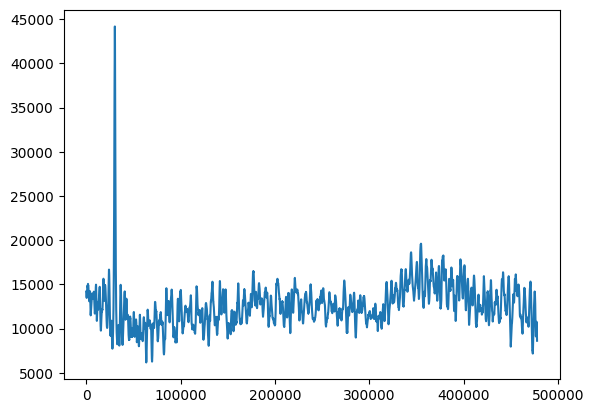

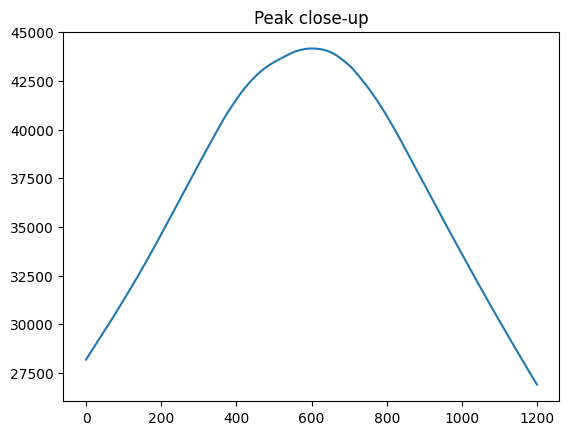

pozitivni


Number of samples and their corresponding correlation:


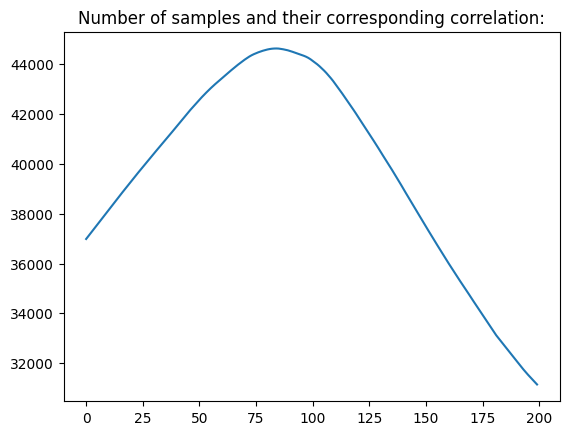

In [8]:
import numpy as np
from scipy import signal
from scipy.signal import resample


def synchronize_by_LED(wisci, video, new_num_samples, visualize=False):
    sig1 = wisci
    sig2 = video
    # sig1 = (sig1 - (np.max(sig1) - np.min(sig1))) / ((np.max(sig1) - np.min(sig1))/2)
    # sig2 = (sig2 - (np.max(sig2) - np.min(sig2))) / ((np.max(sig2) - np.min(sig2))/2)
    shifted_sig1 = sig1 - np.min(sig1[1000:]) #np.mean(sig1) # TODO: here was min(), but I changed it because at the beginning the lighting is very low
    shifted_sig2 = sig2 - np.min(sig2[1000:]) # TODO: here was min(), but I changed it because at the beginning the lighting is very low
    normalized_sig1 = shifted_sig1 / np.max(shifted_sig1) - 0.5
    normalized_sig2 = shifted_sig2 / np.max(shifted_sig2) - 0.5


    original_signal = normalized_sig2  # Your signal data

    # Use scipy's resample to adjust the signal
    resampled_signal = resample(original_signal, new_num_samples)

    normalized_sig2 = resampled_signal


    correlation = signal.correlate(normalized_sig1, normalized_sig2, mode="valid")
    lags = signal.correlation_lags(normalized_sig1.size, normalized_sig2.size, mode="valid")
    lag = lags[np.argmax(np.abs(correlation))]
    if visualize:
        print(lag)
        plt.plot(np.abs(correlation))
        plt.show()

        plt.plot(np.abs(correlation[np.argmax(np.abs(correlation))-600:np.argmax(np.abs(correlation))+600]))
        plt.title("Peak close-up")
        plt.show()

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=np.arange(len(normalized_sig1)), y=normalized_sig1, mode='lines', name='Wisci', line=dict(color='red')))

        # we computed abs(correlation), to visualize the signals, let's align them
        # (if they were anticorrelated, just put minus before the signal)
        if correlation[np.argmax(np.abs(correlation))] > 0:
            print("pozitivni")
            fig.add_trace(go.Scatter(x=np.arange(len(normalized_sig2)) + lag, y=normalized_sig2, mode='lines', name='From video', line=dict(color='blue')))
        else:
            print("negativni")
            fig.add_trace(go.Scatter(x=np.arange(len(normalized_sig2)) + lag, y=-normalized_sig2, mode='lines', name='From video', line=dict(color='blue')))
        fig.show()

    return np.max(np.abs(correlation)), lag



video_led = np.load('/media/vita-w11/T71/UP2001/led_signals/cam0_916512060805_record_04_10_2023_1341_07_LED_signal.npy')
video_duration = np.load('/media/vita-w11/T71/UP2001/mp4/cam0_916512060805_record_04_10_2023_1341_07_duration.npy')
mat_file = '/media/vita-w11/T71/UP2001/WISCI/UP2001_2023_10_04_EESMapping_D20_BSI_reach_openClose/WISCI/2023_10_04_13_38_46/2023_10_04_13_38_46.mat'
wisci_led, wisci_duration = get_LED_data(mat_file)


wisci_freq = len(wisci_led) / wisci_duration
video_freq = len(video_led) / video_duration
print(wisci_freq, video_freq)

new_num_samples = int(len(video_led) * wisci_freq / video_freq)
resampled_video_led = resample(video_led, new_num_samples)

print(wisci_led.shape, resampled_video_led.shape)

corrs = []
lags = []
num_samples = []
for n_samples in np.linspace(new_num_samples - 2000, new_num_samples + 2000, 200):
    corr, lag = synchronize_by_LED(wisci_led, video_led, int(n_samples), visualize=False)
    corrs.append(corr)
    lags.append(lag)
    num_samples.append(int(n_samples))

best_freq = num_samples[np.argmax(np.array(corrs))]
print(best_freq)
corr, lag = synchronize_by_LED(wisci_led, video_led, new_num_samples, visualize=True)

print("Number of samples and their corresponding correlation:")
plt.plot(np.array(corrs))
plt.title("Number of samples and their corresponding correlation:")
plt.show()
